In [13]:
# Add directory above current directory to path
import sys as SYS; SYS.path.insert(0, '..')

# for saving
import os

from collections import defaultdict
import numpy as np
import matplotlib.pyplot as plt

from src import setup
# setup.use_gpu()

In [14]:
from src import ( 
    measurements as measure,
    density_matrix as DM,
    simulation as sim,
    orders,
    order_rules,
    random_unitary,
    simulation)

In [15]:
from Scripts import simulation_CLI as cleo

In [16]:
identity = DM.Identity(DM.energy_basis(4))

In [17]:
for unitary_seed in range(1):
    initial_pops = [.2, .2, .2, .2, .4, .2, .2, .2]
    system = DM.n_thermal_qbits(initial_pops)
    connectivity = "c5"
    unitary_energy_subspace = 1
    ordering_seed = 1
    chunk_size = 2
    order_rule_name = "greedy"
    num_steps = 100
    data = cleo.execute(file_name="greedy",
                       connectivity=connectivity,
                       order_rule_name = order_rule_name, 
                       unitary_seed=unitary_seed,
                       unitary_energy_subspace=unitary_energy_subspace,
                       evolution_generation_type="haar2Qunitary",
                       chunk_size=chunk_size,
                       num_steps=num_steps,
                       initial_pops=initial_pops,
                       verbosity = .9)

90%
simulation complete, extracting and saving data to : ../data/greedy/greedy-8_qubits-c5_connectivity-unitary_energy_subspace_1-unitary_seed_0-order_rule_name_greedy
simulation complete, extracting and saving data to : ../data/greedy/greedy-8_qubits-c5_connectivity-unitary_energy_subspace_1-unitary_seed_0-order_rule_name_greedy


In [18]:
import sys as SYS; SYS.path.insert(0, '../..')
from Scripts import hdf5merge
hdf5merge.merge_hdf5_files("../data/greedy")

In [19]:
for unitary_seed in range(1):
    initial_pops = [.2, .2, .2, .2, .4, .2, .2, .2]
    system = DM.n_thermal_qbits(initial_pops)
    connectivity = "c5"
    unitary_energy_subspace = 1
    ordering_seed = 1
    chunk_size = 2
    order_rule_name = "random"
    num_steps = 100
    data = cleo.execute(file_name="random",
                       connectivity=connectivity,
                       order_rule_name = order_rule_name, 
                       unitary_seed=unitary_seed,
                       unitary_energy_subspace=unitary_energy_subspace,
                       evolution_generation_type="haar2Qunitary",
                       chunk_size=chunk_size,
                       num_steps=num_steps,
                       initial_pops=initial_pops,
                       verbosity = .9)

90%
simulation complete, extracting and saving data to : ../data/random/random-8_qubits-c5_connectivity-unitary_energy_subspace_1-unitary_seed_0-order_rule_name_random
simulation complete, extracting and saving data to : ../data/random/random-8_qubits-c5_connectivity-unitary_energy_subspace_1-unitary_seed_0-order_rule_name_random


In [20]:
import sys as SYS; SYS.path.insert(0, '../..')
from Scripts import hdf5merge
hdf5merge.merge_hdf5_files("../data/random")

In [21]:
import matplotlib.pyplot as plt 
import matplotlib.animation as animation

In [22]:
# Add directory above current directory to path
import sys as SYS; SYS.path.insert(0, '../..')
import h5py
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
from src import ket as ket
from src import density_matrix as DM

In [23]:
newdata1 = dict(h5py.File("../data/greedy/greedy.hdf5"))

In [24]:
newdata2 =  dict(h5py.File("../data/random/random.hdf5"))

In [25]:
def get_pops(data, n_qubits, connectivity,update_rule):
    #dimension 0 is each trial
    #dimension 1 is each time step
    #dimension 2 is each qubit
    result = []
    for trial in data[f'{n_qubits} qubits'][f'{connectivity} connectivity']['unitary energy subspace 1']:
        seed = trial.split(' ')[-1]
        dat = dict(data[f'{n_qubits} qubits'][f'{connectivity} connectivity']['unitary energy subspace 1'][f'unitary seed {seed}'][f'ordering seed {update_rule}']['pops'])
        dat = {int(k.split('(')[0]): dat[k] for k in dat}
        dat = np.array([np.array([dat[k][subkey][()] for subkey in sorted(dat[k])]) for k in sorted(dat)])
        result.append(dat)
    return(np.array(result))

def get_2_qbit_dms(data, n_qubits, connectivity,update_rule):
    basis = ket.canonical_basis(2)
    #dimension 0 is each trial
    #dimension 1 is each time step (recall that sampling step is 5 by default)
    #dimension 2 is qubit pair
    #dimension 3 and 4 is the 2 qubit density matrix
    result = []
    
    def to_tuple(string):
        tuple_elements = string.strip('()').split(',')
        return tuple(int(elem.strip()) for elem in tuple_elements)

    for trial in data[f'{n_qubits} qubits'][f'{connectivity} connectivity']['unitary energy subspace 1']:
        seed = trial.split(' ')[-1]
        dat = dict(data[f'{n_qubits} qubits'][f'{connectivity} connectivity']['unitary energy subspace 1'][f'unitary seed {seed}'][f'ordering seed {update_rule}']['two_qubit_dms'])
        dat = {int(k.split('(')[0]): dat[k] for k in dat}
        
        dat = np.array([{to_tuple(subkey):DM.DensityMatrix(dat[k][subkey],basis) for subkey in sorted(dat[k])} for k in sorted(dat)])
        result.append(dat)
    return(np.array(result))

In [26]:
popsgreedy = get_pops(newdata1,8,"c5","greedy")

In [27]:
twoQdmsgreedy = get_2_qbit_dms(newdata1,8,"c5","greedy")

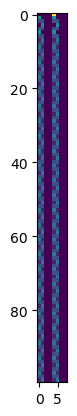

IndexError: index 1 is out of bounds for axis 0 with size 1

In [28]:
for i in range(2):
    plt.imshow(popsgreedy[i], interpolation='none')
    plt.show()

In [18]:
# saves temperature swatches for each simulation index
for i in range(5):
    plt.imshow(popsgreedy[i], interpolation='none')
    plt.savefig(f'plotnumgreedy_{i}.png')   # save the figure to file
    plt.close() 

In [29]:
popsrandom =  get_pops(newdata2,8,"c5","random")

In [30]:
twoQdmsrandom = get_2_qbit_dms(newdata2,8,"c5","random")

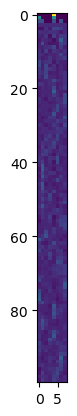

In [31]:
for i in range(1):
    plt.imshow(popsrandom[i], interpolation='none')
    plt.show()

In [ ]:
for i in range(5):
    plt.imshow(popsrandom[i], interpolation='none')
    plt.savefig(f'plotnumrandom_{i}.png')   # save the figure to file
    plt.close() 

In [32]:
# generate exractable work and change in extractable work data for greedy
sizes = [8]
connectivities = ["c5"]
temps = ['cold','hot']
result = {s:{t:{} for t in temps} for s in sizes}
for size in sizes:
    for connectivity in connectivities:
        pops = get_pops(newdata1,size,connectivity,"greedy")
        extractable_work = np.array([[measure.extractable_work_of_each_qubit_from_pops(p) for p in time_slice ]for time_slice in pops ])
        change_in_ex_work = np.diff(extractable_work,axis = 1)
        hot__percent_greater_0 = np.mean(change_in_ex_work[:,:,(4)]>0,axis = 1).flatten()
        cold_percent_greater_0 = np.mean(change_in_ex_work[:,:,(1,2,3,5,6,7)]>0,axis = 1).flatten()
        result[size]['hot'][connectivity] = hot__percent_greater_0
        result[size]['cold'][connectivity] = cold_percent_greater_0

In [33]:
# generate exractable work and change in extractable work data for greedy
sizes = [8]
connectivities = ["c5"]
temps = ['cold','hot']
result_random = {s:{t:{} for t in temps} for s in sizes}
for size in sizes:
    for connectivity in connectivities:
        pops = get_pops(newdata2,size,connectivity,"random")
        extractable_work_random = np.array([[measure.extractable_work_of_each_qubit_from_pops(p) for p in time_slice ]for time_slice in pops ])
        change_in_ex_work_random = np.diff(extractable_work_random,axis = 1)
        hot__percent_greater_0_random = np.mean(change_in_ex_work_random[:,:,(4)]>0,axis = 1).flatten()
        cold_percent_greater_0_random = np.mean(change_in_ex_work_random[:,:,(1,2,3,5,6,7)]>0,axis = 1).flatten()
        result_random[size]['hot'][connectivity] = hot__percent_greater_0_random
        result_random[size]['cold'][connectivity] = cold_percent_greater_0_random

In [ ]:
# generate exractable work and change in extractable work data for update_rule if data set has more than 1 sized network 
sizes = [8,12]
temps = ['cold','hot']
result = {s:{t:{} for t in temps} for s in sizes}
for size in sizes:
    for connectivity in data[f'{size} qubits']:
        print(f'{size} qubits {connectivity}')
        pops = get_pops(data,size,connectivity[:-13])
        extractable_work = np.array([[measure.extractable_work_of_each_qubit_from_pops(p) for p in time_slice ]for time_slice in pops ])
        change_in_ex_work = np.diff(extractable_work,axis = 1)
        hot__percent_greater_0 = np.mean(change_in_ex_work[:,:,(0,4)]>0,axis = 1).flatten()
        cold_percent_greater_0 = np.mean(change_in_ex_work[:,:,(1,2,3,5,6,7)]>0,axis = 1).flatten()
        result[size]['hot'][connectivity] = hot__percent_greater_0
        result[size]['cold'][connectivity] = cold_percent_greater_0

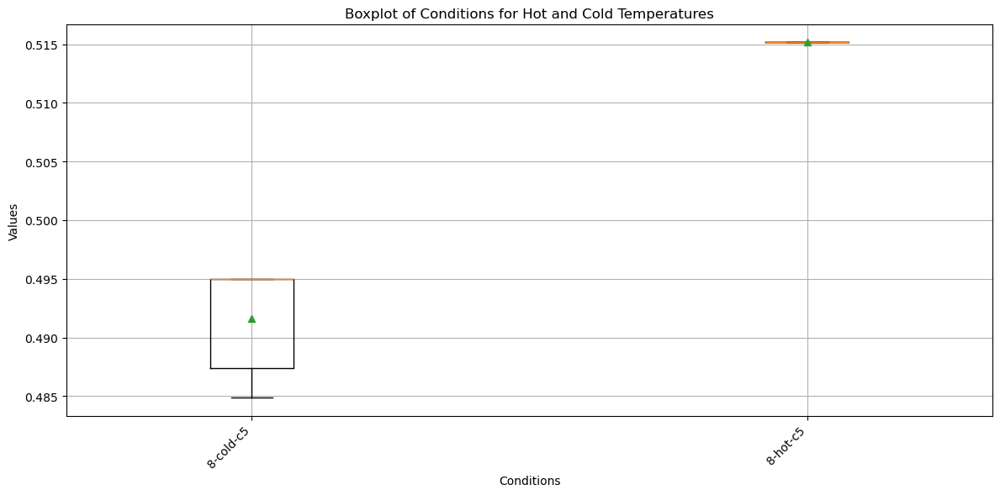

In [34]:
# Extracting data for plotting (greedy)
labels = []
all_data = []
positions = []
num_subgroups = sum(len(inner_dict) for outer_dict in result.values() for inner_dict in outer_dict.values())

i,j,k=0,0,0
for outer_key, outer_value in result.items():
    i+=1
    for inner_key, inner_value in outer_value.items():
        j+=1
        for innermost_key, innermost_value in inner_value.items():
            k+=1
            labels.append(f"{outer_key}-{inner_key}-{innermost_key}")
            all_data.append(innermost_value)
            positions.append(1.2*i+.9*j+.6*k)

# Creating boxplot with custom positions
num_boxes = len(all_data)
num_outer_keys = len(result)
group_gap = 3  # adjust the gap between groups


plt.figure(figsize=(12, 6))
plt.boxplot(all_data, positions=positions, showmeans=True)

plt.xticks(positions, labels, rotation=45, ha='right')
plt.xlabel('Conditions')
plt.ylabel('Values')
plt.title('Boxplot of Conditions for Hot and Cold Temperatures')
plt.grid(True)
plt.tight_layout()
plt.show()

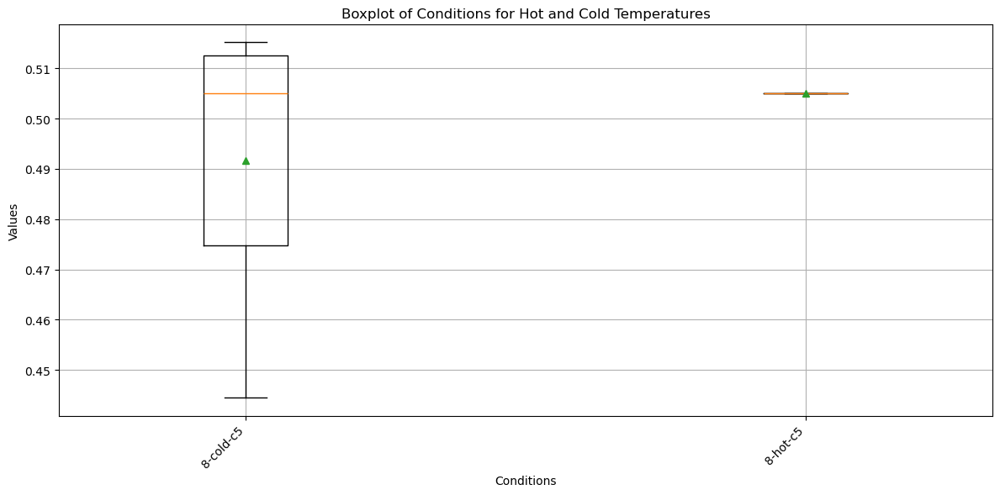

In [35]:
# Extracting data for plotting (random)
labels = []
all_data = []
positions = []
num_subgroups = sum(len(inner_dict) for outer_dict in result_random.values() for inner_dict in outer_dict.values())

i,j,k=0,0,0
for outer_key, outer_value in result_random.items():
    i+=1
    for inner_key, inner_value in outer_value.items():
        j+=1
        for innermost_key, innermost_value in inner_value.items():
            k+=1
            labels.append(f"{outer_key}-{inner_key}-{innermost_key}")
            all_data.append(innermost_value)
            positions.append(1.2*i+.9*j+.6*k)

# Creating boxplot with custom positions
num_boxes = len(all_data)
num_outer_keys = len(result_random)
group_gap = 3  # adjust the gap between groups


plt.figure(figsize=(12, 6))
plt.boxplot(all_data, positions=positions, showmeans=True)

plt.xticks(positions, labels, rotation=45, ha='right')
plt.xlabel('Conditions')
plt.ylabel('Values')
plt.title('Boxplot of Conditions for Hot and Cold Temperatures')
plt.grid(True)
plt.tight_layout()
plt.show()

TypeError: unsupported operand type(s) for /: 'dict' and 'int'

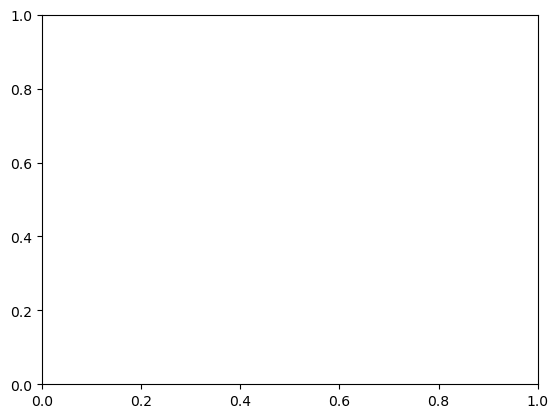

In [48]:

# Extracting data for box plot
hot_data = [result[key]['hot'] for key in result.keys()]
cold_data = [result[key]['cold'] for key in result.keys()]
labels = [f'{key} - Hot' for key in result.keys()] + [f'{key} - Cold' for key in result.keys()]



# Creating box plot
plt.boxplot(hot_data + cold_data, labels=labels)
plt.xlabel('Temperature')
plt.ylabel('Values')
plt.title('Box plot of Hot and Cold data')
plt.grid(True)
plt.xticks(rotation=45)
plt.show()



In [41]:
for sim_index in twoQdmsrandom:
  # Loop through each time_step in the sim_index
    for time_step in sim_index:
        mutual_info = measure.mutual_information_of_every_pair_dict(time_step)
        print(mutual_info)

{(0, 1): -9.592535654689982e-10, (0, 2): -9.592535654689982e-10, (0, 3): -9.592535654689982e-10, (0, 4): -7.713824667909819e-08, (0, 5): -8.512223326206936e-08, (0, 6): -8.512223326206936e-08, (0, 7): -8.512223326206936e-08, (1, 2): -9.592535654689982e-10, (1, 3): -9.592535654689982e-10, (1, 4): -7.713824667909819e-08, (1, 5): -8.512223326206936e-08, (1, 6): -8.512223326206936e-08, (1, 7): -8.512223326206936e-08, (2, 3): -9.592535654689982e-10, (2, 4): -7.713824667909819e-08, (2, 5): -8.512223326206936e-08, (2, 6): -8.512223326206936e-08, (2, 7): -8.512223326206936e-08, (3, 4): -7.713824667909819e-08, (3, 5): -8.512223326206936e-08, (3, 6): -8.512223326206936e-08, (3, 7): -8.512223326206936e-08, (4, 5): -7.713824667909819e-08, (4, 6): -7.713824667909819e-08, (4, 7): -7.713824667909819e-08, (5, 6): -9.592535654689982e-10, (5, 7): -9.592535654689982e-10, (6, 7): -9.592535654689982e-10}
{(0, 1): -5.965864402490695e-08, (0, 2): -5.965864402490695e-08, (0, 3): -5.965864402490695e-08, (0, 4)

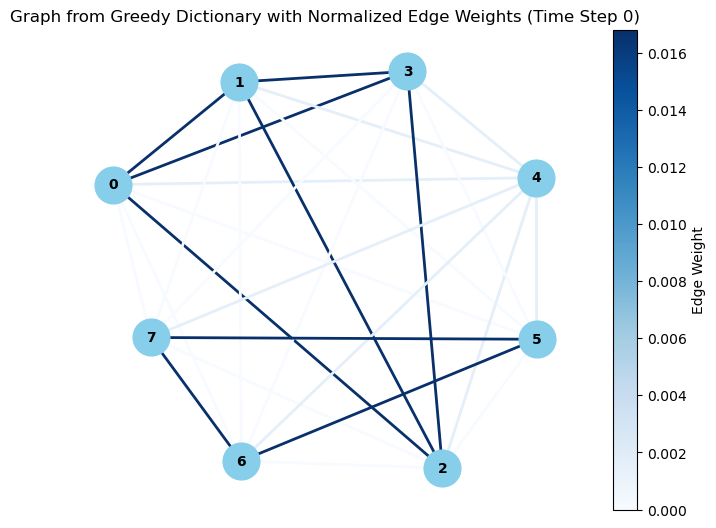

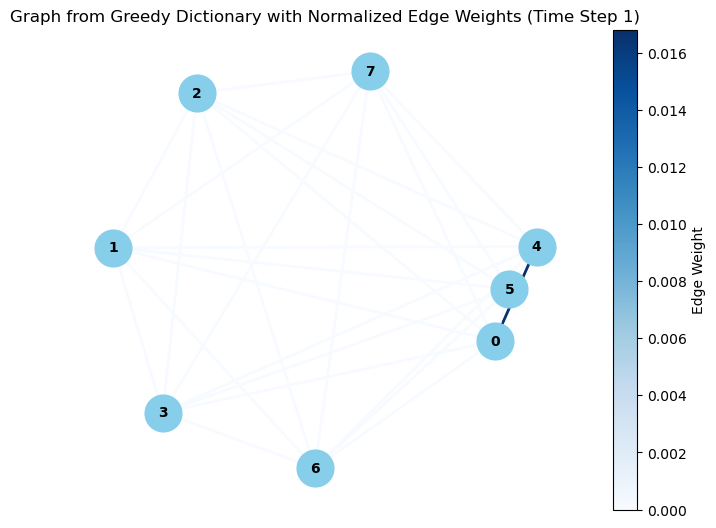

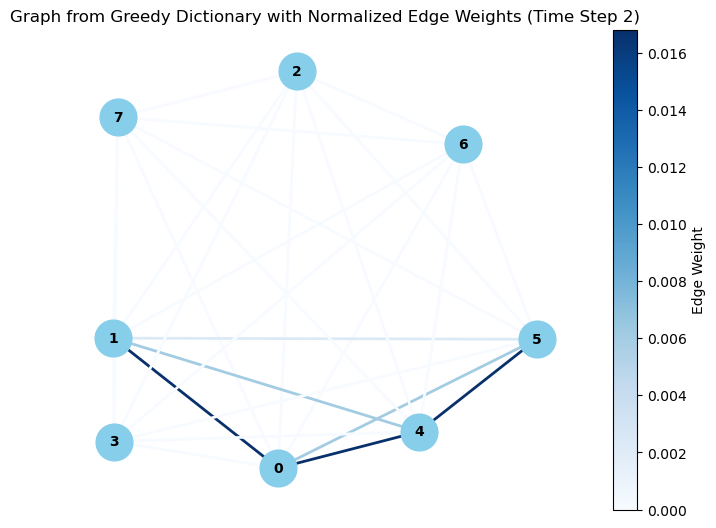

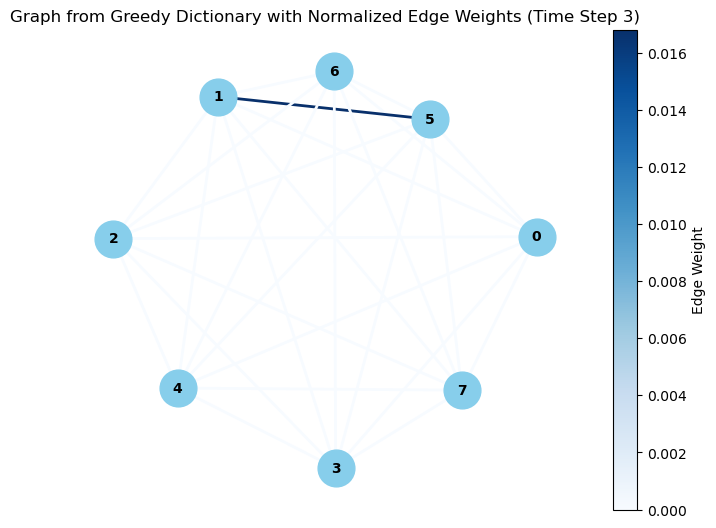

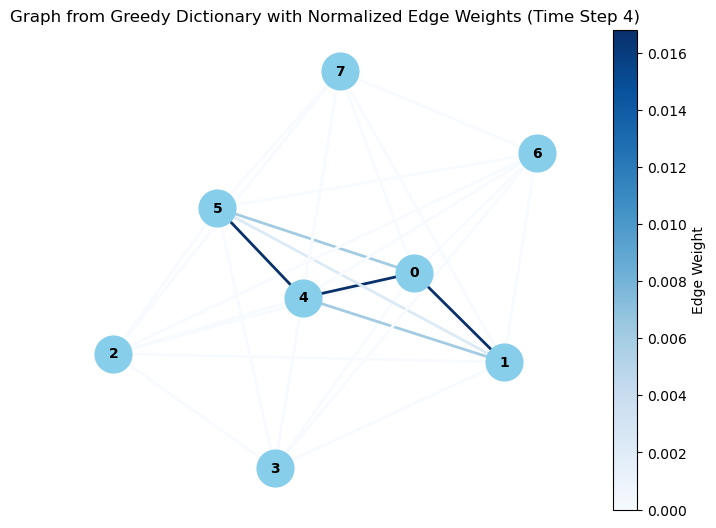

...

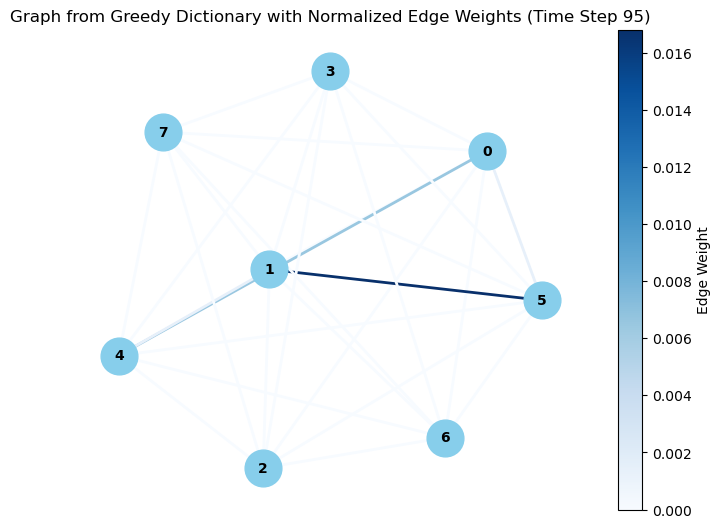

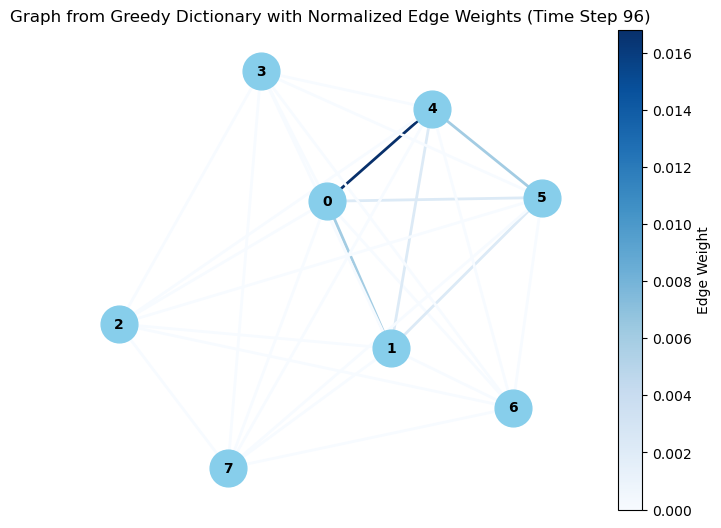

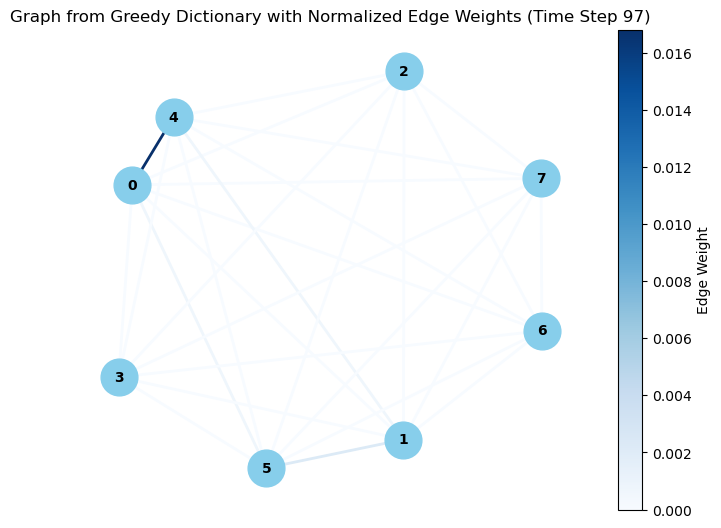

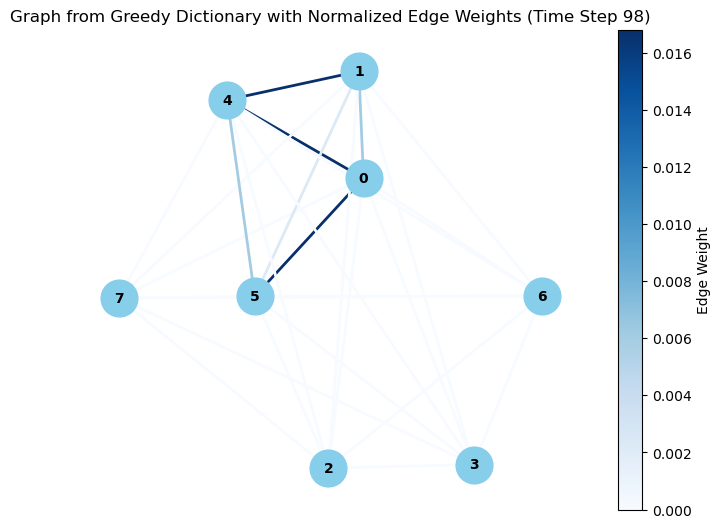

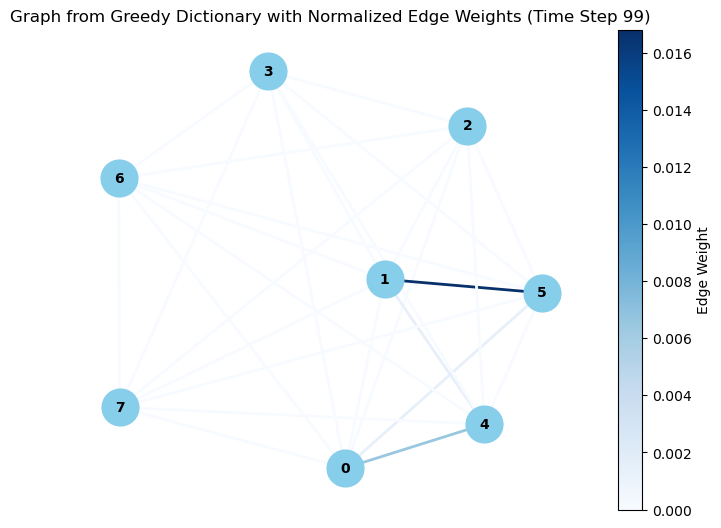

In [40]:
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable

# Loop through each sim_index
for sim_index in twoQdmsgreedy:
    # Create an empty list to store networks for this sim_index
    networks = []
    
    # Loop through each time_step in the sim_index
    for time_step in sim_index:
        mutual_information = measure.mutual_information_of_every_pair_dict(time_step)
    
        # Create a graph object
        G = nx.Graph()
        
        # Add edges from the dictionary
        for edge, weight in mutual_information.items():
            G.add_edge(*edge, weight=weight)
        
        # Normalize edge weights
        edge_weights = [weight for _, _, weight in G.edges(data='weight')]
        norm = Normalize(vmin=min(edge_weights), vmax=max(edge_weights))
        
        # Create a colormap for edge colors
        cmap = plt.cm.Blues
        
        # Add edges with normalized weights and colored edges
        for u, v, data in G.edges(data=True):
            norm_weight = norm(data['weight'])
            G[u][v]['norm_weight'] = norm_weight
            G[u][v]['color'] = cmap(norm_weight)
        
        # Append the graph to the list of networks for this sim_index
        networks.append(G)
    
    # Now plot all networks for this sim_index
    for i, G in enumerate(networks):
        # Draw the graph
        pos = nx.spring_layout(G)  # Positions for all nodes
        nx.draw(G, pos, with_labels=True, node_size=700, node_color='skyblue', font_size=10, font_weight='bold',
                edge_color=[data['color'] for _, _, data in G.edges(data=True)], width=2.0)
        
        # Create a ScalarMappable for colormap and normalize
        sm = ScalarMappable(cmap=cmap, norm=norm)
        sm.set_array([])
        cbar = plt.colorbar(sm, ax=plt.gca())  # Use current axis (gca)
        cbar.set_label('Edge Weight')
        
        plt.title(f"Graph from Greedy Dictionary with Normalized Edge Weights (Time Step {i})")
        plt.show()

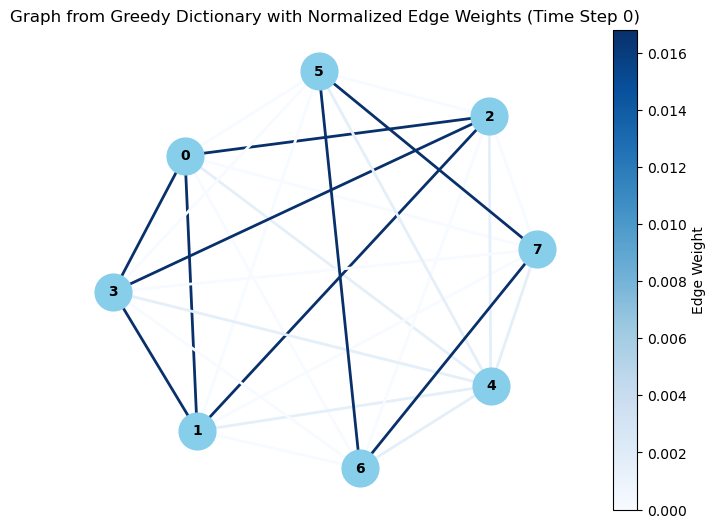

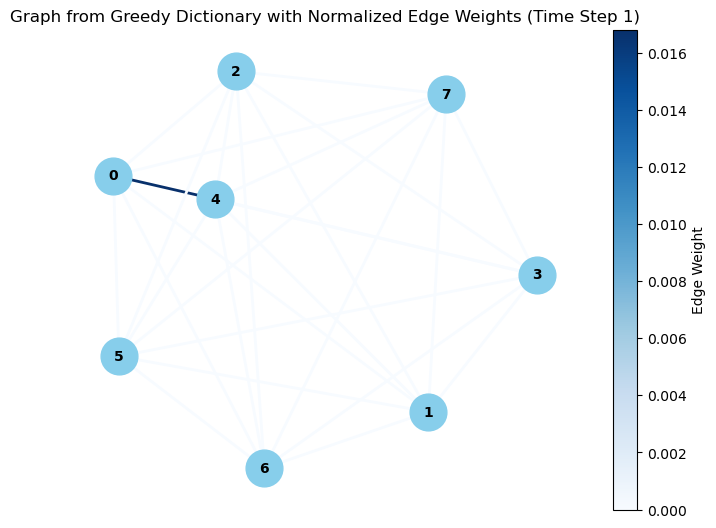

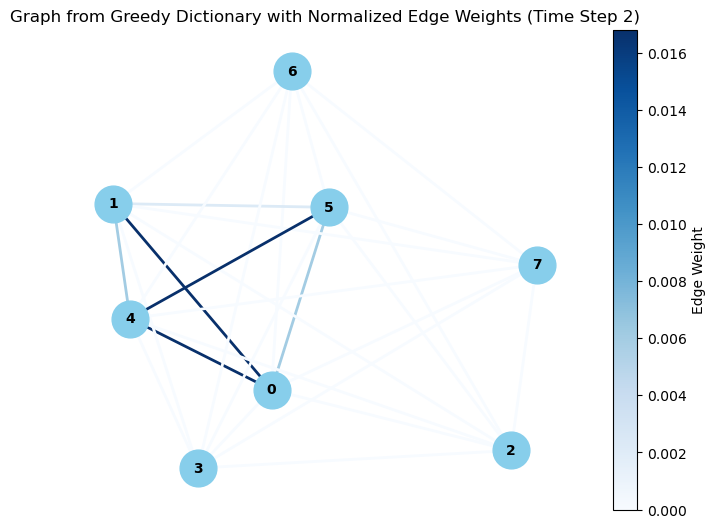

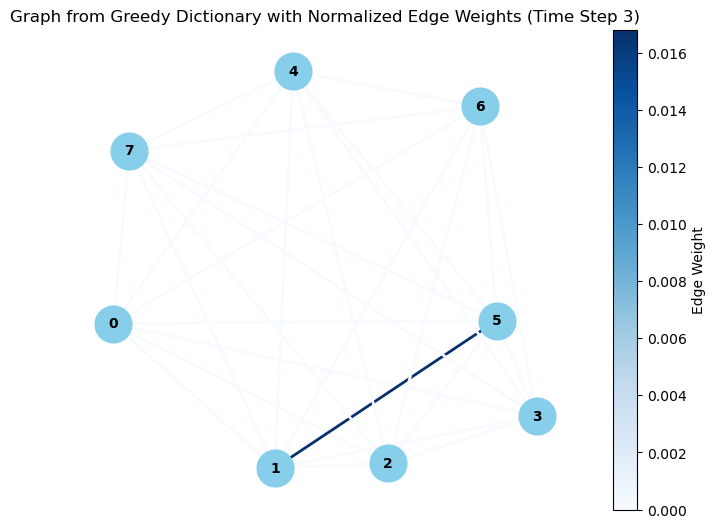

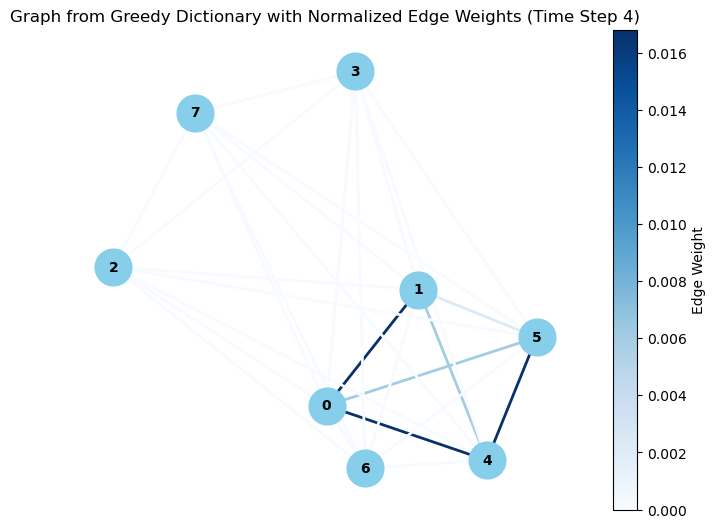

...

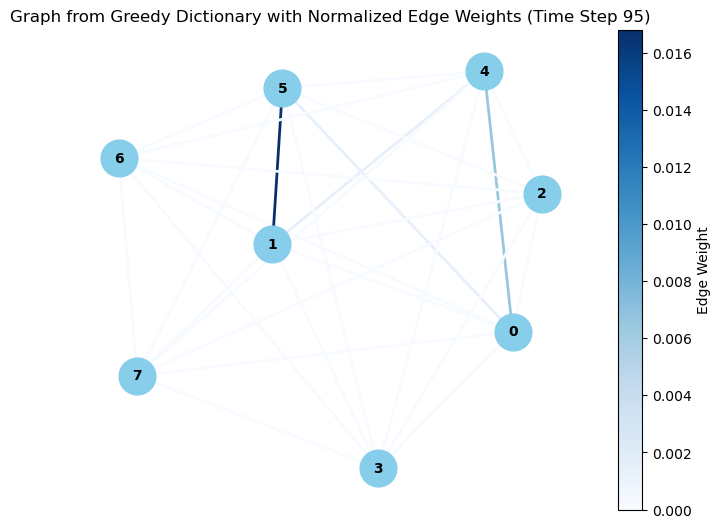

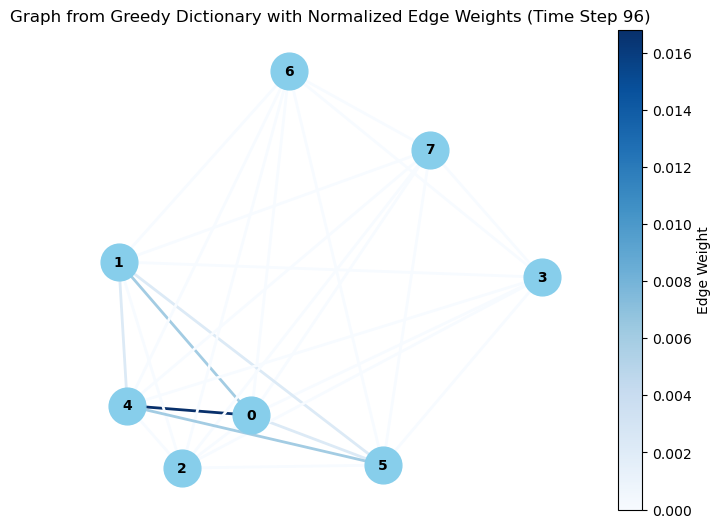

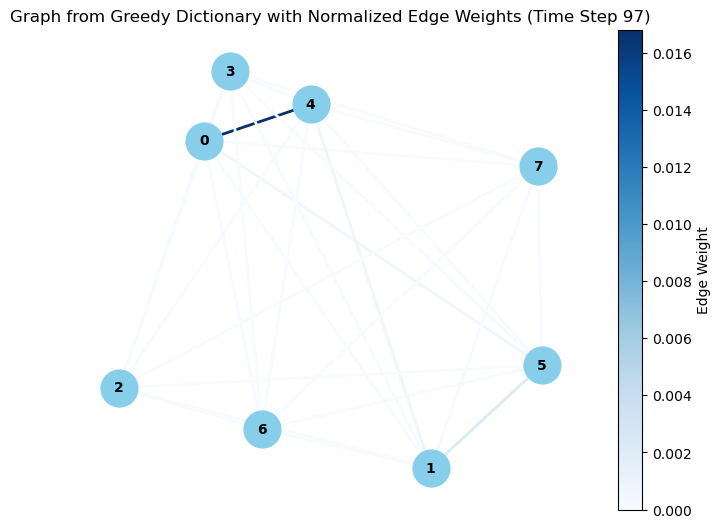

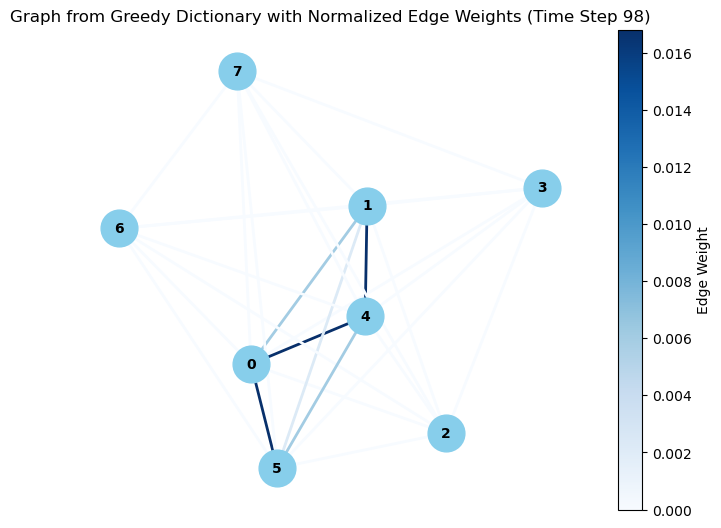

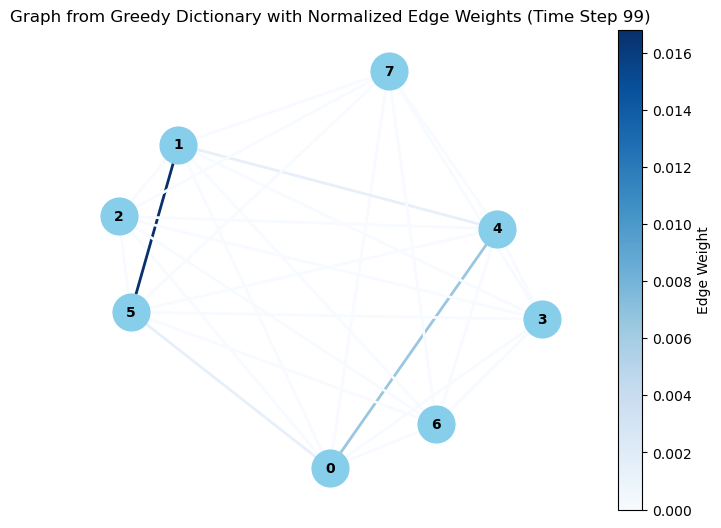

In [28]:
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable

# Loop through each sim_index
for sim_index in twoQdmsgreedy:
    # Create an empty list to store networks for this sim_index
    networks = []
    
    # Loop through each time_step in the sim_index
    for time_step in sim_index:
        mutual_information = measure.mutual_information_of_every_pair_dict(time_step)
    
        # Create a graph object
        G = nx.Graph()
        
        # Add edges from the dictionary
        for edge, weight in mutual_information.items():
            G.add_edge(*edge, weight=weight)
        
        # Normalize edge weights
        edge_weights = [weight for _, _, weight in G.edges(data='weight')]
        norm = Normalize(vmin=min(edge_weights), vmax=max(edge_weights))
        
        # Create a colormap for edge colors
        cmap = plt.cm.Blues
        
        # Add edges with normalized weights and colored edges
        for u, v, data in G.edges(data=True):
            norm_weight = norm(data['weight'])
            G[u][v]['norm_weight'] = norm_weight
            G[u][v]['color'] = cmap(norm_weight)
        
        # Append the graph to the list of networks for this sim_index
        networks.append(G)
    
    # Now plot all networks for this sim_index
    for i, G in enumerate(networks):
        # Draw the graph
        pos = nx.spring_layout(G)  # Positions for all nodes
        nx.draw(G, pos, with_labels=True, node_size=700, node_color='skyblue', font_size=10, font_weight='bold',
                edge_color=[data['color'] for _, _, data in G.edges(data=True)], width=2.0)
        
        # Create a ScalarMappable for colormap and normalize
        sm = ScalarMappable(cmap=cmap, norm=norm)
        sm.set_array([])
        cbar = plt.colorbar(sm, ax=plt.gca())  # Use current axis (gca)
        cbar.set_label('Edge Weight')
        
        plt.title(f"Graph from Greedy Dictionary with Normalized Edge Weights (Time Step {i})")
        plt.show()

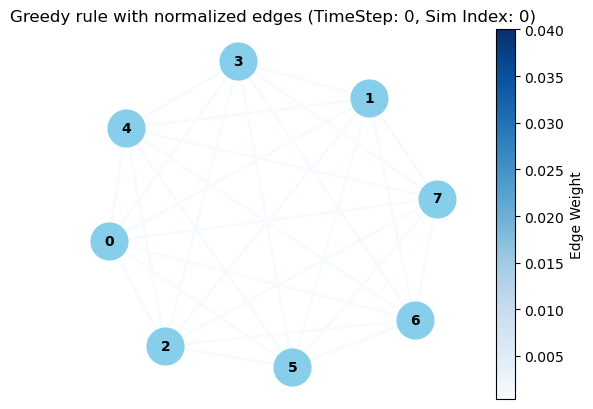

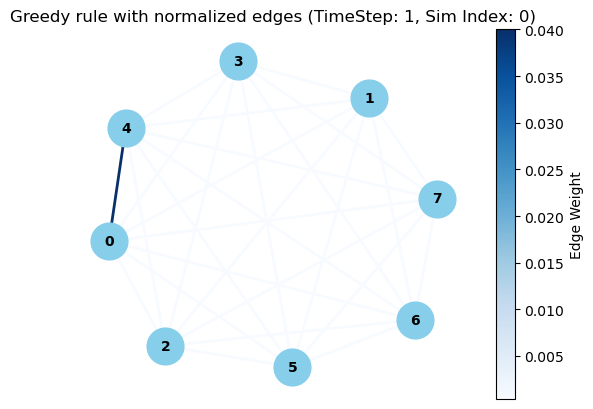

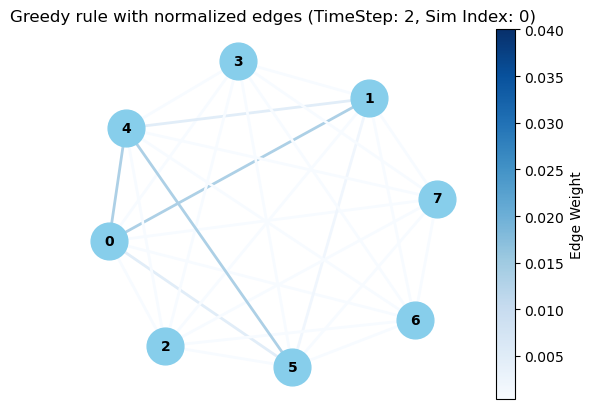

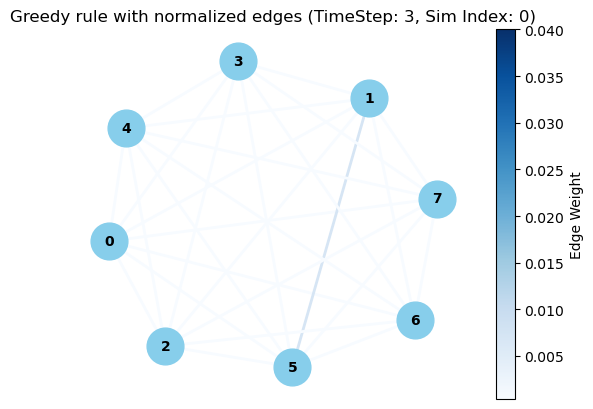

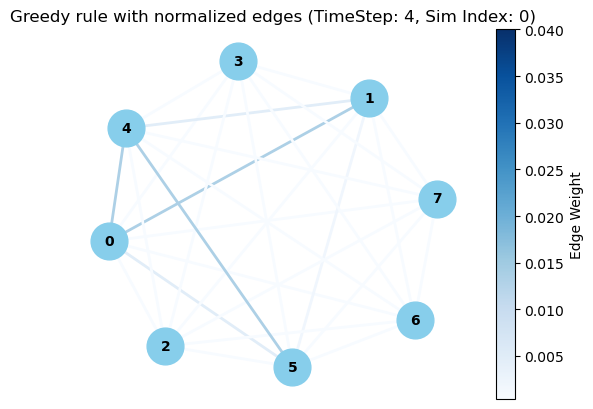

...

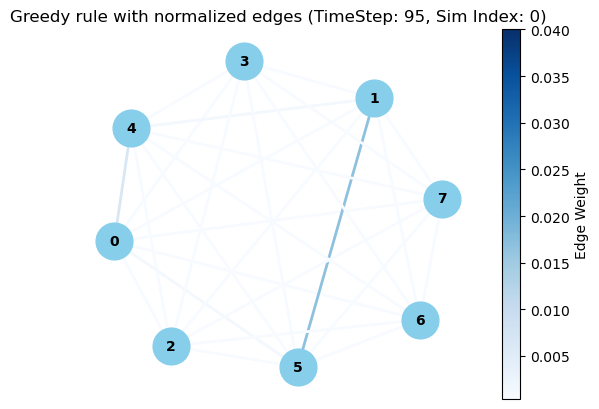

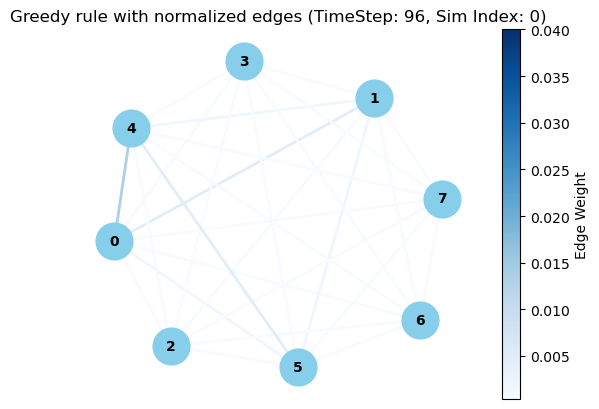

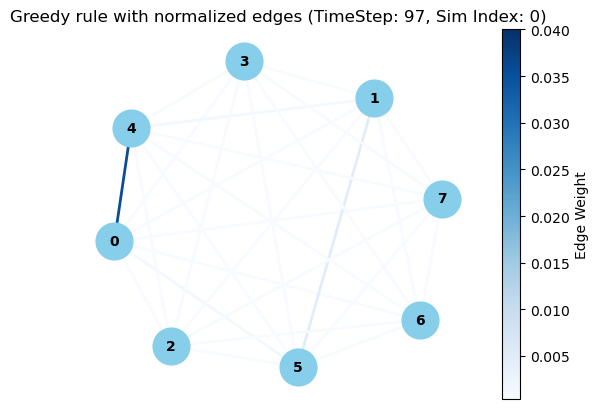

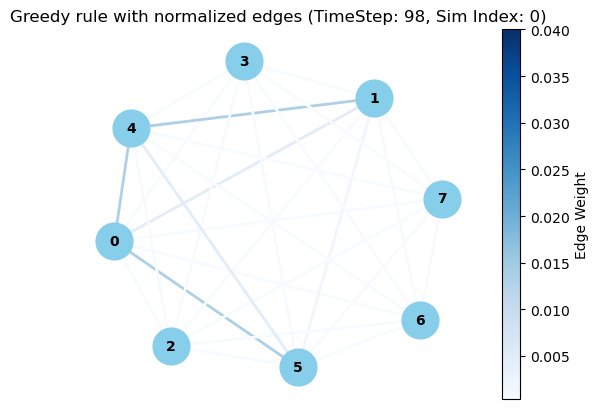

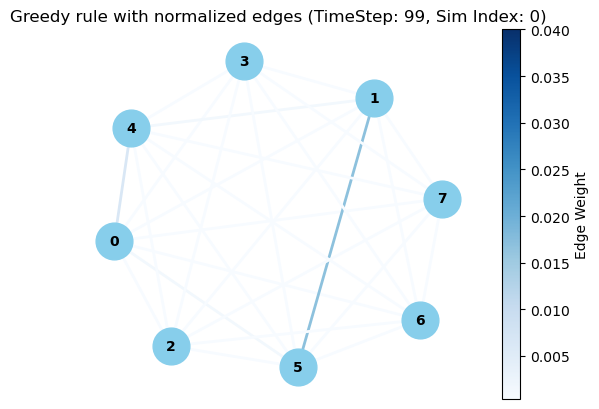

In [51]:
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable
import matplotlib.pyplot as plt
import networkx as nx

# Set desired minimum and maximum values for color bar
colorbar_min = 0.0004
colorbar_max = 0.04

# Calculate fixed node positions outside the loop
fixed_node_positions = nx.spring_layout(G)

# Loop through each sim_index
for sim_index_idx, sim_index in enumerate(twoQdmsgreedy):
    # Create an empty list to store networks for this sim_index
    networks = []
    
    # Loop through each time_step in the sim_index
    for time_step_idx, time_step in enumerate(sim_index):
        mutual_information = measure.mutual_information_of_every_pair_dict(time_step)
    
        # Create a graph object
        G = nx.Graph()
        
        # Add edges from the dictionary
        for edge, weight in mutual_information.items():
            G.add_edge(*edge, weight=weight)
        
        # Normalize edge weights
        edge_weights = [weight for _, _, weight in G.edges(data='weight')]
        norm = Normalize(vmin=min(edge_weights), vmax=max(edge_weights))
        norm.vmin = colorbar_min  # Set the desired minimum value
        norm.vmax = colorbar_max  # Set the desired maximum value
        
        # Create a colormap for edge colors
        cmap = plt.cm.Blues
        
        # Add edges with normalized weights and colored edges
        for u, v, data in G.edges(data=True):
            norm_weight = norm(data['weight'])
            G[u][v]['norm_weight'] = norm_weight
            G[u][v]['color'] = cmap(norm_weight)
        
        # Append the graph to the list of networks for this sim_index
        networks.append((G, time_step_idx))
    
    # Now plot and save all networks for this sim_index
    for i, (G, time_step_idx) in enumerate(networks):
        # Create a new figure and axis
        fig, ax = plt.subplots()
        
        # Draw the graph with fixed node positions
        nx.draw(G, fixed_node_positions, with_labels=True, node_size=700, node_color='skyblue',
                font_size=10, font_weight='bold', edge_color=[data['color'] for _, _, data in G.edges(data=True)],
                width=2.0, ax=ax)
        
        # Create a ScalarMappable for colormap and normalize
        sm = ScalarMappable(cmap=cmap, norm=norm)
        sm.set_array([])
        cbar = plt.colorbar(sm, ax=ax)  # Use current axis (ax)
        cbar.set_label('Edge Weight')
        
        # Set the color bar limits
        sm.set_clim(colorbar_min, colorbar_max)
        
        plt.title(f"Greedy rule with normalized edges (TimeStep: {time_step_idx}, Sim Index: {sim_index_idx})")
        
        # Save the figure with filename indicating time_step and sim_index
        filename = f"network_sim_{sim_index_idx}_time_{time_step_idx}_greedy_longtime.png"
        plt.savefig(filename)
        plt.show()
        plt.close()

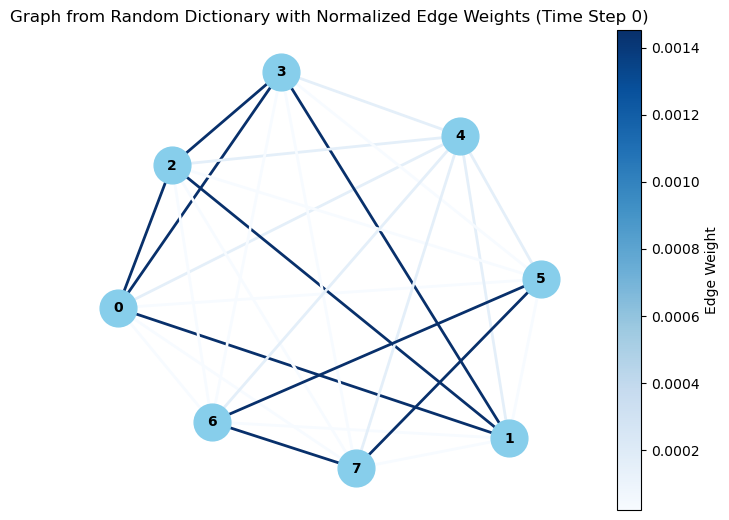

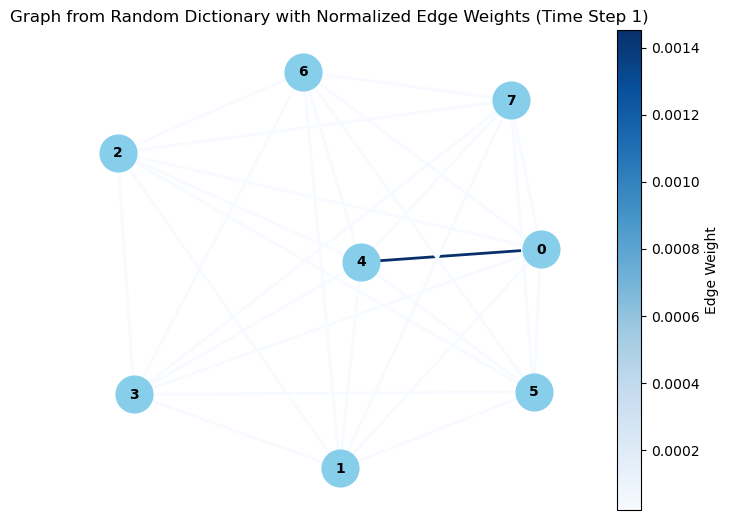

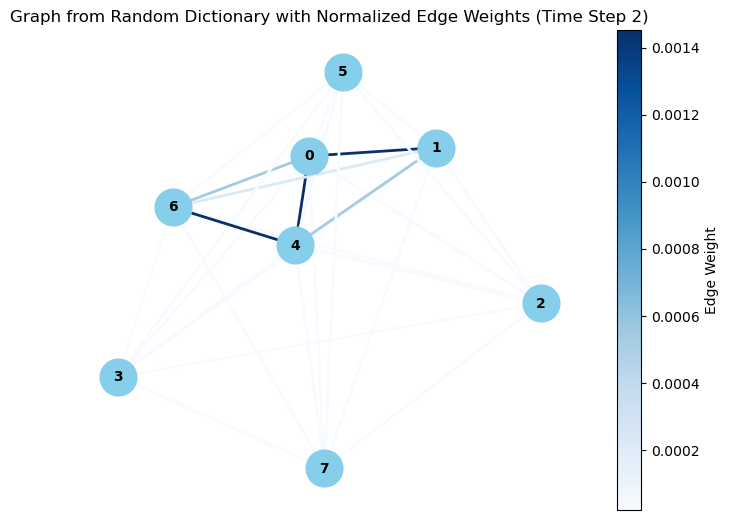

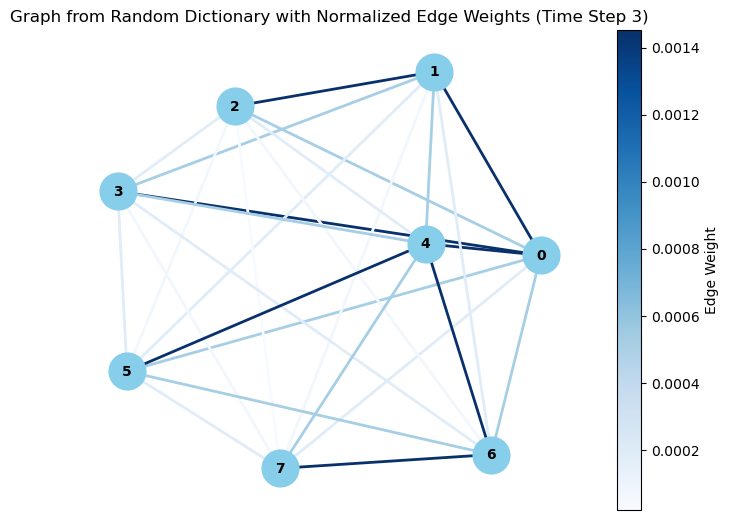

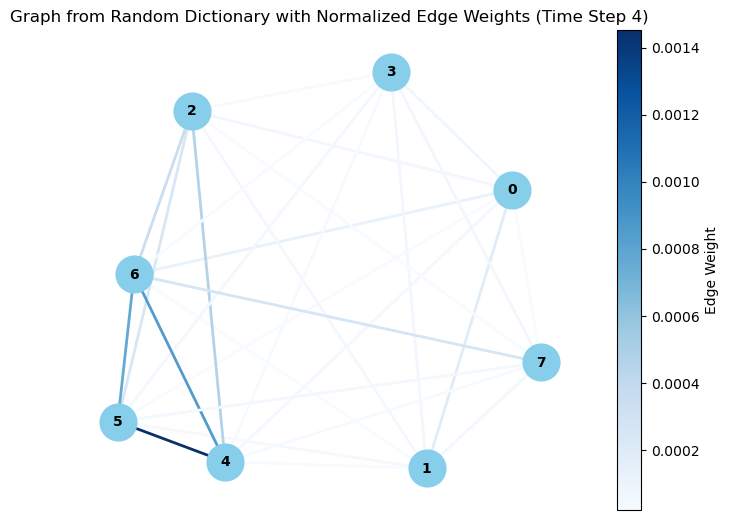

...

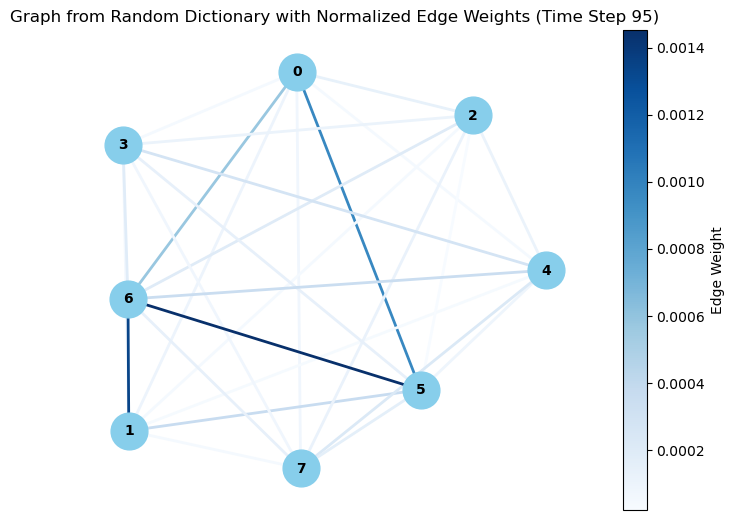

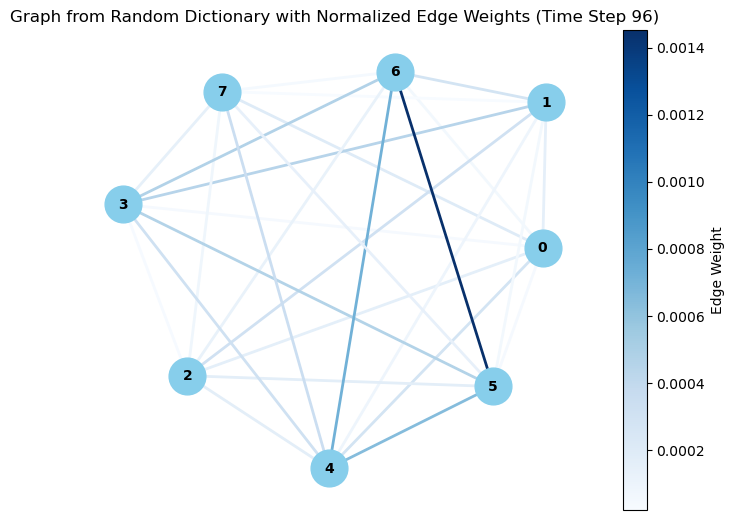

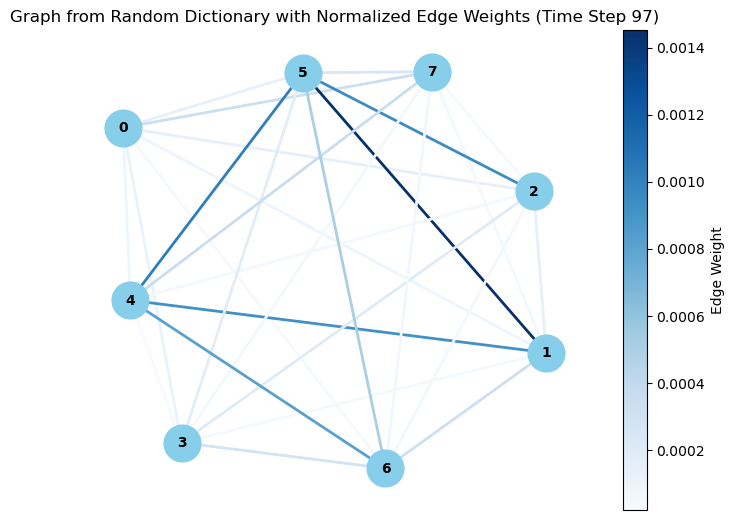

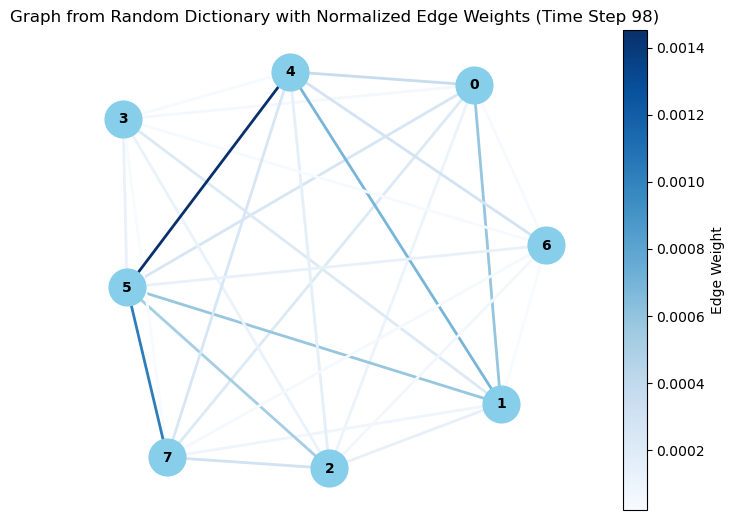

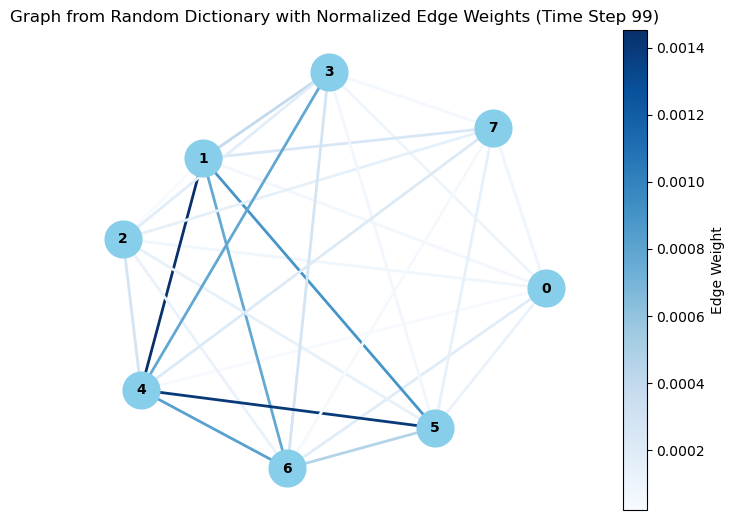

In [49]:
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable

# Loop through each sim_index
for sim_index in twoQdmsrandom:
    # Create an empty list to store networks for this sim_index
    networks = []
    
    # Loop through each time_step in the sim_index
    for time_step in sim_index:
        mutual_information_random = measure.mutual_information_of_every_pair_dict(time_step)
    
        # Create a graph object
        G = nx.Graph()
        
        # Add edges from the dictionary
        for edge, weight in mutual_information_random.items():
            G.add_edge(*edge, weight=weight)
        
        # Normalize edge weights
        edge_weights = [weight for _, _, weight in G.edges(data='weight')]
        norm = Normalize(vmin=min(edge_weights), vmax=max(edge_weights))
        
        # Create a colormap for edge colors
        cmap = plt.cm.Blues
        
        # Add edges with normalized weights and colored edges
        for u, v, data in G.edges(data=True):
            norm_weight = norm(data['weight'])
            G[u][v]['norm_weight'] = norm_weight
            G[u][v]['color'] = cmap(norm_weight)
        
        # Append the graph to the list of networks for this sim_index
        networks.append(G)
    
    # Now plot all networks for this sim_index
    for i, G in enumerate(networks):
        # Draw the graph
        pos = nx.spring_layout(G)  # Positions for all nodes
        nx.draw(G, pos, with_labels=True, node_size=700, node_color='skyblue', font_size=10, font_weight='bold',
                edge_color=[data['color'] for _, _, data in G.edges(data=True)], width=2.0)
        
        # Create a ScalarMappable for colormap and normalize
        sm = ScalarMappable(cmap=cmap, norm=norm)
        sm.set_array([])
        cbar = plt.colorbar(sm, ax=plt.gca())  # Use current axis (gca)
        cbar.set_label('Edge Weight')
        
        plt.title(f"Graph from Random Dictionary with Normalized Edge Weights (Time Step {i})")
        plt.show()

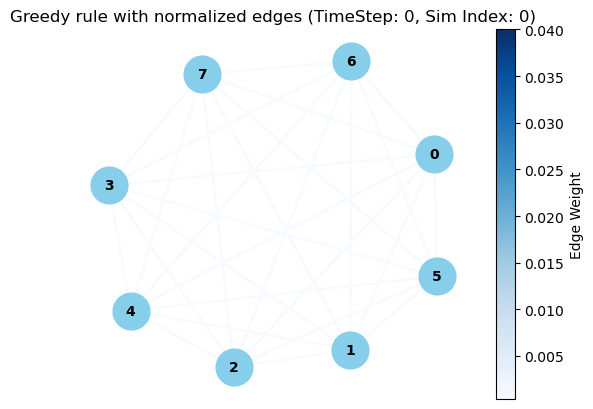

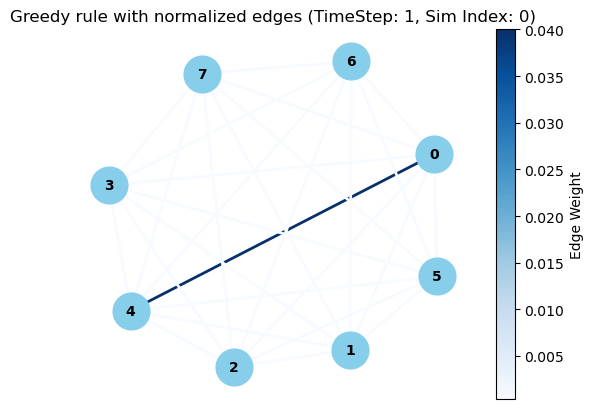

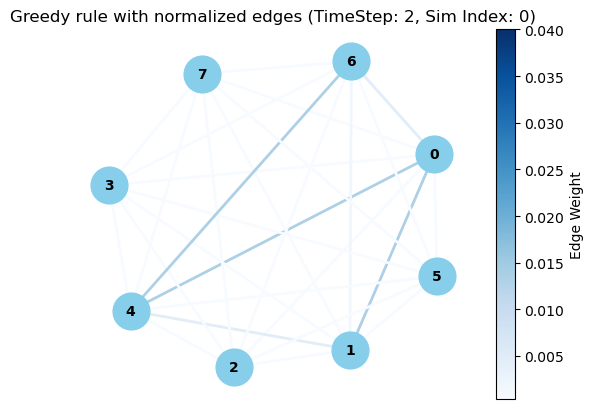

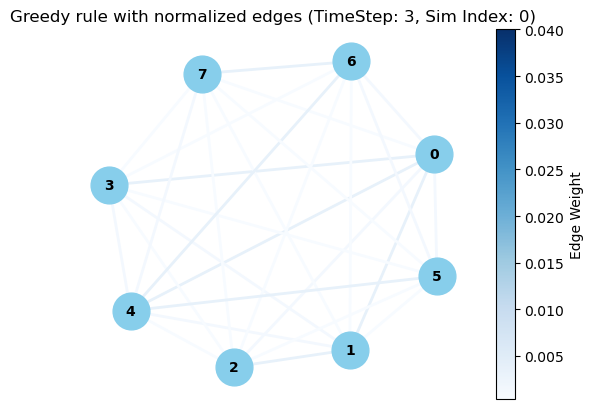

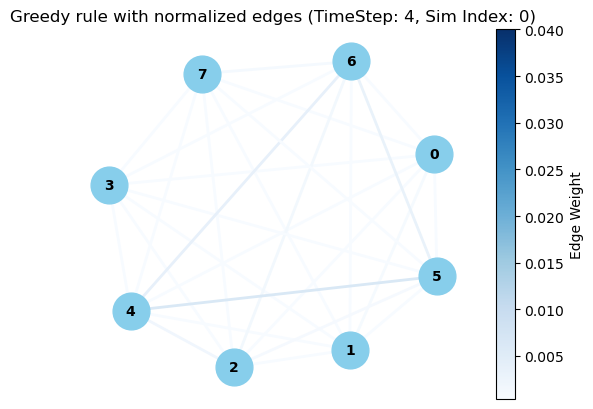

...

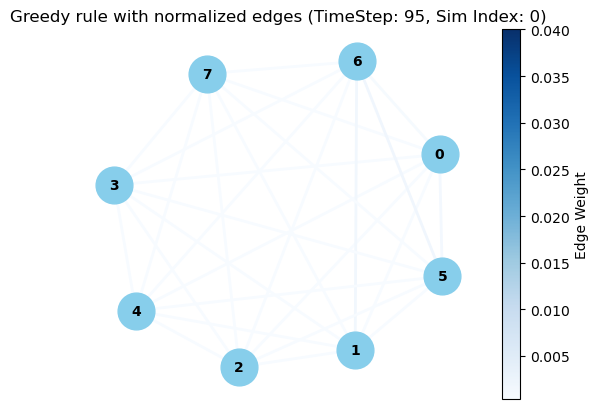

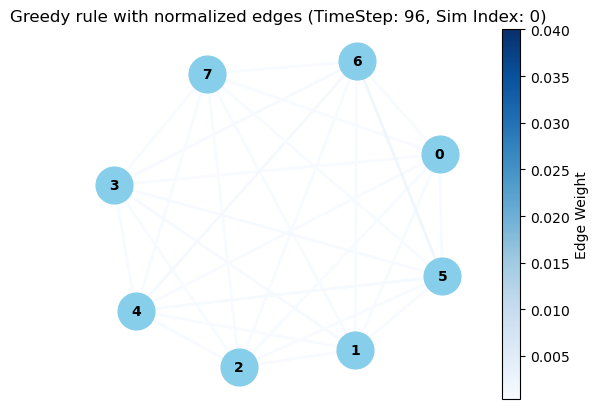

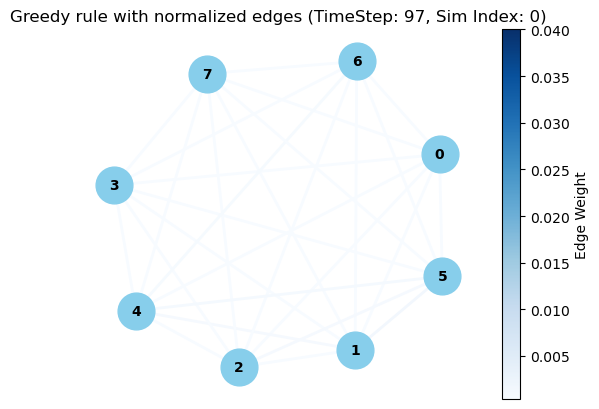

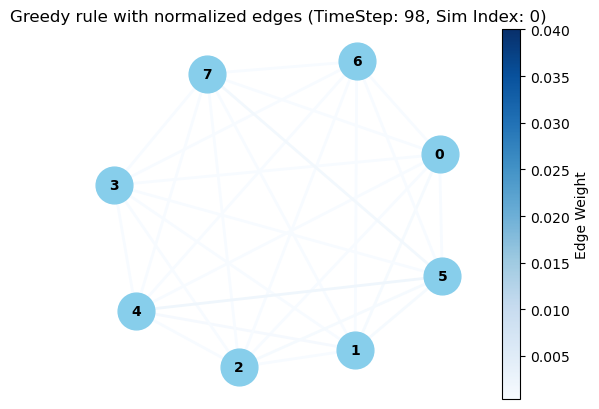

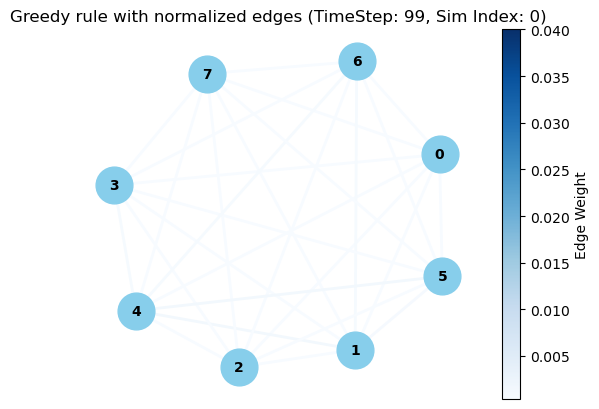

In [50]:
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable
import matplotlib.pyplot as plt
import networkx as nx

# Set desired minimum and maximum values for color bar
colorbar_min = 0.0004
colorbar_max = 0.04

# Calculate fixed node positions outside the loop
fixed_node_positions = nx.spring_layout(G)

# Loop through each sim_index
for sim_index_idx, sim_index in enumerate(twoQdmsrandom):
    # Create an empty list to store networks for this sim_index
    networks = []
    
    # Loop through each time_step in the sim_index
    for time_step_idx, time_step in enumerate(sim_index):
        mutual_information_random = measure.mutual_information_of_every_pair_dict(time_step)
    
        # Create a graph object
        G = nx.Graph()
        
        # Add edges from the dictionary
        for edge, weight in mutual_information_random.items():
            G.add_edge(*edge, weight=weight)
        
        # Normalize edge weights
        edge_weights = [weight for _, _, weight in G.edges(data='weight')]
        norm = Normalize(vmin=min(edge_weights), vmax=max(edge_weights))
        norm.vmin = colorbar_min  # Set the desired minimum value
        norm.vmax = colorbar_max  # Set the desired maximum value
        
        # Create a colormap for edge colors
        cmap = plt.cm.Blues
        
        # Add edges with normalized weights and colored edges
        for u, v, data in G.edges(data=True):
            norm_weight = norm(data['weight'])
            G[u][v]['norm_weight'] = norm_weight
            G[u][v]['color'] = cmap(norm_weight)
        
        # Append the graph to the list of networks for this sim_index
        networks.append((G, time_step_idx))
    
    # Now plot and save all networks for this sim_index
    for i, (G, time_step_idx) in enumerate(networks):
        # Create a new figure and axis
        fig, ax = plt.subplots()
        
        # Draw the graph with fixed node positions
        nx.draw(G, fixed_node_positions, with_labels=True, node_size=700, node_color='skyblue',
                font_size=10, font_weight='bold', edge_color=[data['color'] for _, _, data in G.edges(data=True)],
                width=2.0, ax=ax)
        
        # Create a ScalarMappable for colormap and normalize
        sm = ScalarMappable(cmap=cmap, norm=norm)
        sm.set_array([])
        cbar = plt.colorbar(sm, ax=ax)  # Use current axis (ax)
        cbar.set_label('Edge Weight')
        
        # Set the color bar limits
        sm.set_clim(colorbar_min, colorbar_max)
        
        plt.title(f"Greedy rule with normalized edges (TimeStep: {time_step_idx}, Sim Index: {sim_index_idx})")
        
        # Save the figure with filename indicating time_step and sim_index
        filename = f"network_sim_{sim_index_idx}_time_{time_step_idx}_random_longtime.png"
        plt.savefig(filename)
        plt.show()
        plt.close()

In [46]:
for sim_index in twoQdmsgreedy:
    # Create an empty list to store networks for this sim_index
    networks = []
    
    # Loop through each time_step in the sim_index
    for time_step in sim_index:
        mutual_information_random = measure.mutual_information_of_every_pair_dict(time_step)
        # declaring an empty list
        listr = []
        # appending all the values in the list
        for value in mutual_information_random.values():
            listr.append(value)
        # calculating standard deviation using np.std
        std = np.std(listr)*10000
        meann=np.mean(listr)*10000    
        # printing results
        print(max(listr),"mean:",meann , "std:",std)
    

-9.592535654689982e-10 mean: -0.0005607385028527645 std: 0.0003806490376183281
0.048314446618045626 mean: 17.25409036204059 std: 89.66064463490058
0.013403418941473566 mean: 18.462381310513525 std: 41.990977631555516
0.0070662150578209015 mean: 2.520696697249477 std: 13.113828929562192
0.013403221591702374 mean: 18.46127407160019 std: 41.990715205474764
0.04831426334614286 mean: 17.250938979106138 std: 89.66089841080796
0.013403255554826465 mean: 18.460050046239676 std: 41.99122510151364
0.016815547848540113 mean: 9.351326154631936 std: 32.98269541417948
0.013403218256119676 mean: 10.168731300006426 std: 27.21230848485537
0.03566162687550878 mean: 15.492485280076327 std: 66.33590113448403
0.013403011793056141 mean: 18.457094767997315 std: 41.99157966691301
0.016815257088840907 mean: 9.348211052814486 std: 32.98288190449548
0.013402901843697856 mean: 10.16594828539449 std: 27.21222283706833
0.035661420139262434 mean: 15.48959927403353 std: 66.33608665853221
0.013402870568923086 mean: 18

In [81]:
for sim_index in twoQdmsgreedy:
    # Create an empty list to store networks for this sim_index
    networks = []
    
    # Loop through each time_step in the sim_index
    for time_step in sim_index:
        mutual_information = measure.mutual_information_of_every_pair_dict(time_step)
        # declaring an empty list
        listr = []
        # appending all the values in the list
        for value in mutual_information.values():
            listr.append(value)
        # calculating standard deviation using np.std
        std = np.std(listr)*10000
        meann=np.mean(listr)*10000    
        # printing results
        #print(max(listr)*10000,"mean:",meann , "std:",std)

In [87]:
initial_pops = [.2, .2, .2, .2, .4, .2, .2, .2]
initial_pops_thermal = [.225, .225, .225, .225, .225, .225, .225, .225]
system = DM.n_thermal_qbits(initial_pops)
system_thermal = DM.n_thermal_qbits(initial_pops_thermal)
(measure.entropy(system_thermal)-measure.entropy(system))*(1/8)
    

0.01116170375350134

In [85]:
import numpy as np

# Initialize an empty 2D array to store mean and std
mean_std_array = []

# Loop through each sim_index
for sim_index in twoQdmsrandom:
    # Create an empty list to store mean and std for this sim_index
    sim_mean_std = []
    
    # Loop through each time_step in the sim_index
    for time_step in sim_index:
        mutual_information_random = measure.mutual_information_of_every_pair_dict(time_step)
        # declaring an empty list
        listr = []
        # appending all the values in the list
        for value in mutual_information_random.values():
            listr.append(value)
        # calculating standard deviation using np.std
        std = np.std(listr)*100
        mean = np.mean(listr)
        
        # Append mean and std to the list for this time step
        sim_mean_std.append([mean, std])
    
    # Append the list for this sim_index to the 2D array
    mean_std_array.append(sim_mean_std)

# Convert the list of lists to a numpy array
mean_std_array = np.array(mean_std_array)

# Print the array
#print(mean_std_array[0])

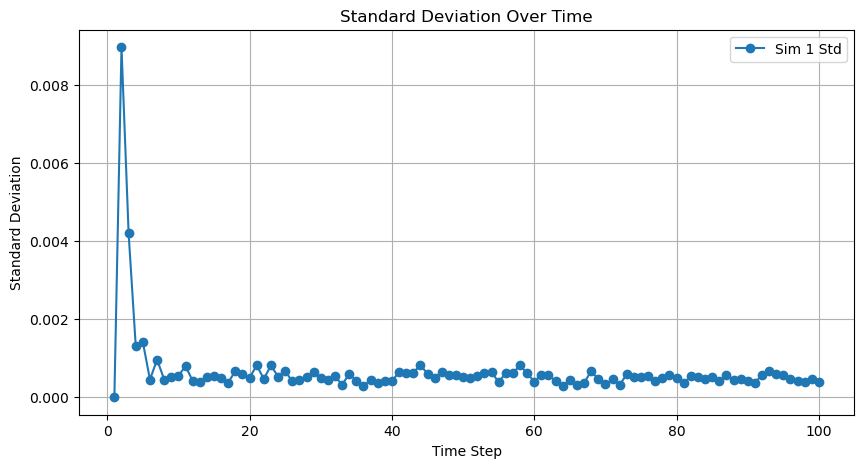

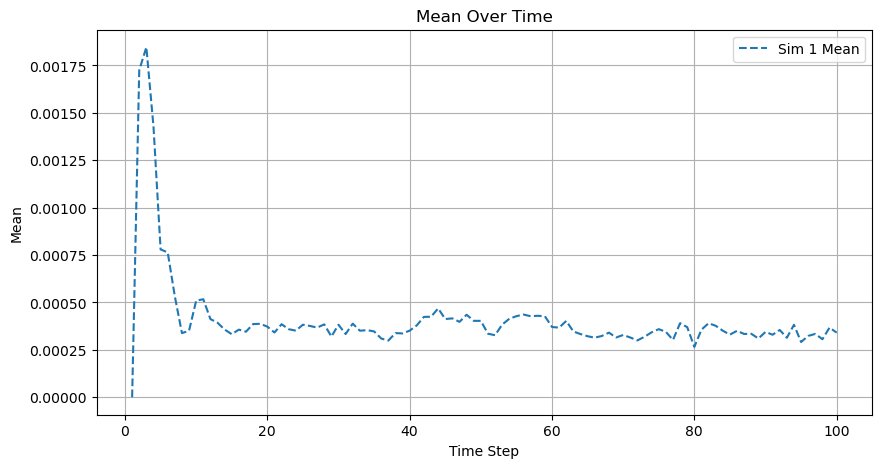

In [61]:
import numpy as np
import matplotlib.pyplot as plt

# Initialize an empty 2D array to store mean and std
mean_std_array = []

# Loop through each sim_index
for sim_index in twoQdmsrandom:
    # Create an empty list to store mean and std for this sim_index
    sim_mean_std = []
    
    # Loop through each time_step in the sim_index
    for time_step in sim_index:
        mutual_information_random = measure.mutual_information_of_every_pair_dict(time_step)
        # declaring an empty list
        listr = []
        # appending all the values in the list
        for value in mutual_information_random.values():
            listr.append(value)
        # calculating standard deviation using np.std
        std = np.std(listr)
        mean = np.mean(listr)
        
        # Append mean and std to the list for this time step
        sim_mean_std.append([mean, std])
    
    # Append the list for this sim_index to the 2D array
    mean_std_array.append(sim_mean_std)

# Convert the list of lists to a numpy array
mean_std_array = np.array(mean_std_array)

# Extract standard deviation and mean values for each simulation
stds_random = mean_std_array[:, :, 1]
means = mean_std_array[:, :, 0]

# Create x-axis values (time steps)
time_steps = np.arange(1, stds.shape[1] + 1)

# Plot standard deviation for each simulation
plt.figure(figsize=(10, 5))
for sim_idx in range(len(stds)):
    plt.plot(time_steps, stds_random[sim_idx], '-o', label=f'Sim {sim_idx + 1} Std')

plt.xlabel('Time Step')
plt.ylabel('Standard Deviation')
plt.title('Standard Deviation Over Time')
plt.legend()
plt.grid(True)
plt.show()

# Plot mean for each simulation
plt.figure(figsize=(10, 5))
for sim_idx in range(len(means)):
    plt.plot(time_steps, means[sim_idx], '--', label=f'Sim {sim_idx + 1} Mean')

plt.xlabel('Time Step')
plt.ylabel('Mean')
plt.title('Mean Over Time')
plt.legend()
plt.grid(True)
plt.show()


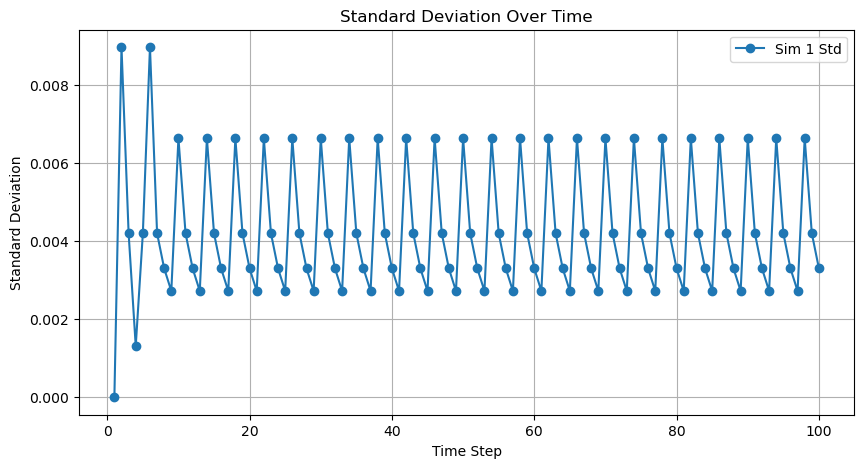

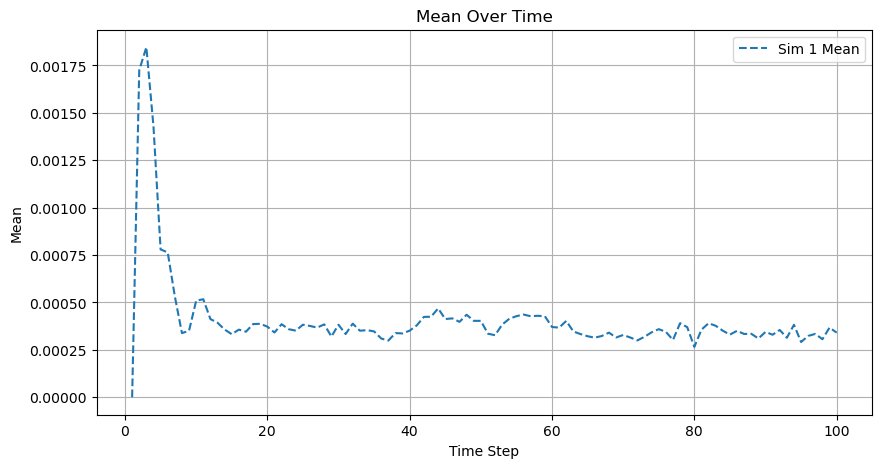

In [62]:
import numpy as np
import matplotlib.pyplot as plt

# Initialize an empty 2D array to store mean and std
mean_std_array = []

# Loop through each sim_index
for sim_index in twoQdmsgreedy:
    # Create an empty list to store mean and std for this sim_index
    sim_mean_std = []
    
    # Loop through each time_step in the sim_index
    for time_step in sim_index:
        mutual_information = measure.mutual_information_of_every_pair_dict(time_step)
        # declaring an empty list
        listr = []
        # appending all the values in the list
        for value in mutual_information.values():
            listr.append(value)
        # calculating standard deviation using np.std
        std = np.std(listr)
        mean = np.mean(listr)
        
        # Append mean and std to the list for this time step
        sim_mean_std.append([mean, std])
    
    # Append the list for this sim_index to the 2D array
    mean_std_array.append(sim_mean_std)

# Convert the list of lists to a numpy array
mean_std_array = np.array(mean_std_array)

# Extract standard deviation and mean values for each simulation
stds_greedy = mean_std_array[:, :, 1]
means_greedy = mean_std_array[:, :, 0]

# Create x-axis values (time steps)
time_steps = np.arange(1, stds.shape[1] + 1)

# Plot standard deviation for each simulation
plt.figure(figsize=(10, 5))
for sim_idx in range(len(stds)):
    plt.plot(time_steps, stds[sim_idx], '-o', label=f'Sim {sim_idx + 1} Std')

plt.xlabel('Time Step')
plt.ylabel('Standard Deviation')
plt.title('Standard Deviation Over Time')
plt.legend()
plt.grid(True)
plt.show()

# Plot mean for each simulation
plt.figure(figsize=(10, 5))
for sim_idx in range(len(means)):
    plt.plot(time_steps, means[sim_idx], '--', label=f'Sim {sim_idx + 1} Mean')

plt.xlabel('Time Step')
plt.ylabel('Mean')
plt.title('Mean Over Time')
plt.legend()
plt.grid(True)
plt.show()

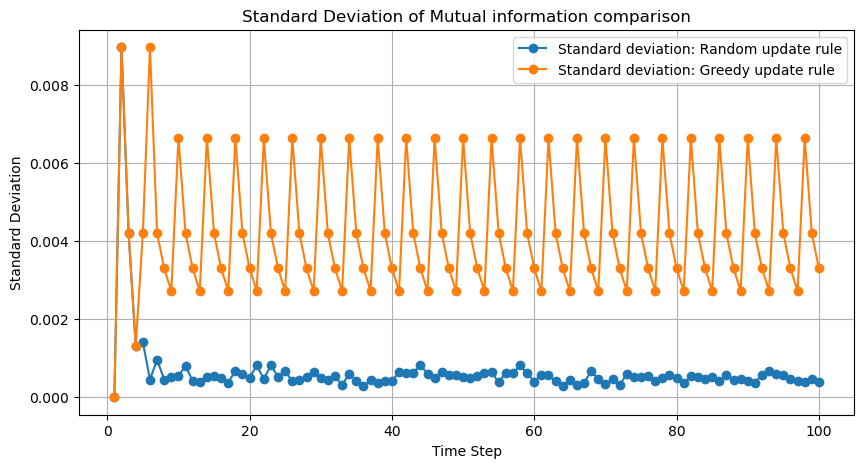

In [63]:
import numpy as np
import matplotlib.pyplot as plt

# Example data for stds1 and stds2 (replace these with your actual data)
time_steps = np.arange(1, 101)
stds1 =stds_random[0]
stds2 = stds_greedy[0]

# Plot stds1 and stds2 on the same plot
plt.figure(figsize=(10, 5))
plt.plot(time_steps, stds1, '-o', label='Standard deviation: Random update rule')
plt.plot(time_steps, stds2, '-o', label='Standard deviation: Greedy update rule')
plt.xlabel('Time Step')
plt.ylabel('Standard Deviation')
plt.title('Standard Deviation of Mutual information comparison')
plt.legend()
plt.grid(True)
filename = f"SD_different_update_rules.png"
plt.savefig(filename)
plt.show()



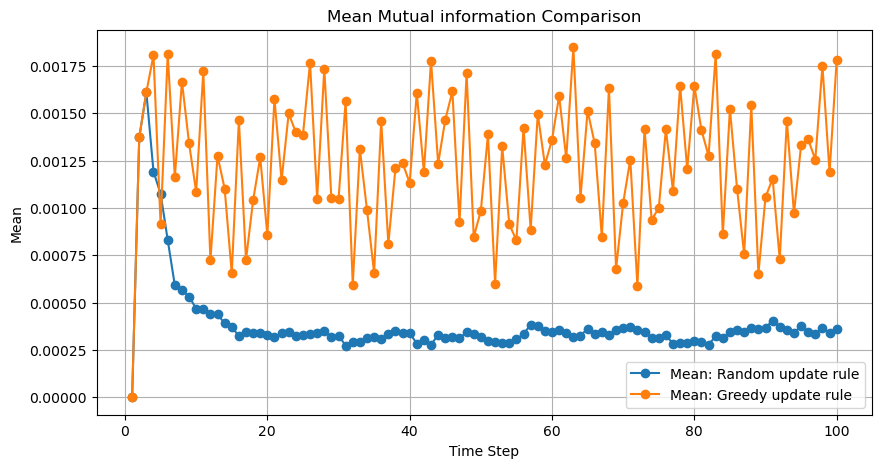

In [77]:
import numpy as np
import matplotlib.pyplot as plt

# Example data for stds1 and stds2 (replace these with your actual data)
time_steps = np.arange(1, 101)
means1 = means[0]
means2 = means_first_sim 

# Plot stds1 and stds2 on the same plot
plt.figure(figsize=(10, 5))
plt.plot(time_steps, means1, '-o', label='Mean: Random update rule')
plt.plot(time_steps, means2, '-o', label='Mean: Greedy update rule')
plt.xlabel('Time Step')
plt.ylabel('Mean')
plt.title('Mean Mutual information Comparison')
plt.legend()
plt.grid(True)
# Save the figure with filename indicating time_step and sim_index
filename = f"MI_different_update_rules.png"
plt.savefig(filename)
plt.show()